In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("soumikrakshit/classical-music-midi")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\Madhusowmya\.cache\kagglehub\datasets\soumikrakshit\classical-music-midi\versions\1


In [2]:
pip install "numpy<2"

Note: you may need to restart the kernel to use updated packages.


In [3]:
!pip install music21
#Importing Libraries
import tensorflow 
import numpy as np 
import pandas as pd 
from collections import Counter
import random
import IPython
from IPython.display import Image, Audio
import music21
from music21 import *
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import sys
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")
np.random.seed(42)

In [4]:
import os
from tqdm.notebook import tqdm
#Loading the list of chopin's midi files as stream 
filepath = "archive (5)/borodin/"
#Getting midi files
all_midis= []
for i in tqdm(os.listdir(filepath)):
    if i.endswith(".mid"):
        tr = filepath+i
        midi = converter.parse(tr)
        all_midis.append(midi)

  0%|          | 0/7 [00:00<?, ?it/s]

In [5]:
def extract_feature(file):
    notes = []
    pick = None
    for j in tqdm(file, desc='Processing Files', unit='file'):
        songs = instrument.partitionByInstrument(j)
        for part in songs.parts:
            pick = part.recurse()
            for element in pick:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append(".".join(str(n) for n in element.normalOrder))
                    
    return notes

In [6]:
Corpus = extract_feature(all_midis)
print('Total notes in all the Chopin midis in the dataset:', len(Corpus))

Processing Files:   0%|          | 0/7 [00:00<?, ?file/s]

Total notes in all the Chopin midis in the dataset: 4753


In [7]:
print(Corpus[:50])


['0.3.6.8', 'C#1', '9.1.4', 'C#1', '3.6.9.11', 'C#1', '1.4.8', 'C#1', '3.6.8', 'C3', 'C#1', '4.9', 'C#3', 'C#1', '6.9.11', 'E-3', 'C#1', '8.1', 'E3', 'C#1', '2.6.9', 'F#3', 'C#1', 'C#1', '3.6.9', 'C3', 'C#1', 'C#1', '8.1', 'E3', 'C#1', '6.11', 'E-3', 'C#1', '8.1', 'E3', 'C#1', '6.11', 'E-3', 'C#1', '8.1', 'E3', 'C#1', 'C#1', 'G#4', 'C#5', 'E-5', 'E5', 'E-5', 'C#5']


In [8]:
#to play audio or corpus
print("Sample Audio From Data")
IPython.display.Audio("archive (5)/Corpus_Snippet.wav") 

Sample Audio From Data


In [9]:
from collections import Counter

count_num = Counter(Corpus)

print("Total unique notes in the Corpus:", len(count_num))

Total unique notes in the Corpus: 165


In [10]:
# Exploring the notes dictionary
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
# Average recurrent for a note in Corpus
def Average(lis):
    return sum(lis) / len(lis)
print('Average recurrence for a note in corpus:', Average(Recurrence))
print('Most frequent note in corpus appeared:', max(Recurrence), 'times')
print('Least frequent note in corpus appeared:', min(Recurrence), 'times')

Average recurrence for a note in corpus: 28.806060606060605
Most frequent note in corpus appeared: 166 times
Least frequent note in corpus appeared: 1 times


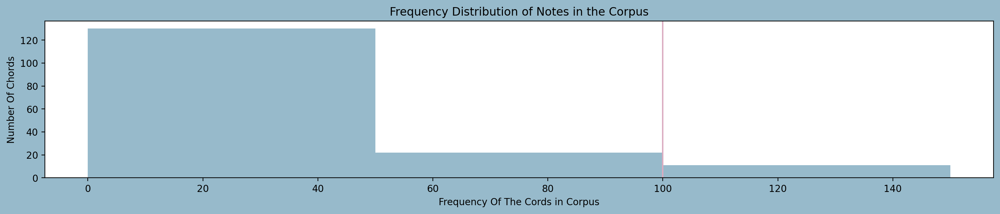

In [11]:
plt.figure(figsize=(18, 3), facecolor='#97BACB')
bins = np.arange(0,(max(Recurrence)), 50)
plt.hist(Recurrence, bins=bins, color='#97BACB')
plt.axvline(x=100, color='#DBACC1')
plt.title('Frequency Distribution of Notes in the Corpus')
plt.xlabel('Frequency Of The Cords in Corpus')
plt.ylabel('Number Of Chords')
plt.show()

In [12]:
# taking note which played less than 100 times
rare_note = []
for index, (key, value) in enumerate(count_num.items()):
    if value < 100 :
        m = key
        rare_note.append(m)
        
print('Total number of notes that occur less then 100 times:', len(rare_note))

Total number of notes that occur less then 100 times: 152


In [13]:
# Eleminating the rare note
for element in Corpus:
    if element in rare_note:
        Corpus.remove(element)
        
print('Length of corpus after elemination the rare notes', len(Corpus))

Length of corpus after elemination the rare notes 2862


In [14]:
symb=sorted(list(set(Corpus)))
L_corpus =len(Corpus) # length of corpus
L_symb = len(symb) # Length of total unique character
# Building dictonary to access the vocabulary from indices and vice versa
mapping = dict((c, i) for i,c in enumerate(symb))
reverse_mapping = dict((i, c) for i, c in enumerate(symb))

print("Total number of characters:", L_corpus)
print('Number of unique characters:', L_symb)

Total number of characters: 2862
Number of unique characters: 143


In [15]:
# Encoding and Spliting dataset
length = 40
features = []
targets = []
for i in range(0, L_corpus - length, 1):
    feature = Corpus[i:i + length]
    target = Corpus[i + length]
    features.append([mapping[j] for  j in feature])
    targets.append(mapping[target])
    
L_datapoints = len(targets)
print('Total number of sequences in the corpus:', L_datapoints)

Total number of sequences in the corpus: 2822


In [16]:
X = (np.reshape(features, (L_datapoints, length, 1))) / float(L_symb)
y = tensorflow.keras.utils.to_categorical(targets)

In [17]:
xtrain,xtest,ytrain,ytest = train_test_split(X,y,test_size=.2)

In [18]:
from tensorflow.keras.layers import Bidirectional
model = Sequential()
model.add(Bidirectional(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True)))
model.add(Dropout(0.1))
model.add(Bidirectional(LSTM(256)))
model.add(Dense(256))
model.add(Dropout(0.1))
model.add(Dense(y.shape[1], activation='softmax'))

opt = Adamax(learning_rate=0.01)
model.compile(loss='categorical_crossentropy', optimizer=opt)
model.build(input_shape=(None, X.shape[1], X.shape[2]))

In [19]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ bidirectional (Bidirectional)   │ (None, 40, 1024)       │     2,105,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 40, 1024)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_1 (Bidirectional) │ (None, 512)            │     2,623,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 143)            │        36,751 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,896,911 (18.68 MB)

 Trainable params: 4,896,911 (18.68 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:
history = model.fit(xtrain,ytrain,batch_size=256, epochs=1000)

Epoch 1/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 201s 3s/step - loss: 6.5009
Epoch 2/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 4.3973
Epoch 3/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 4.0845
Epoch 4/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 31s 3s/step - loss: 4.0411
Epoch 5/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 4.0525
Epoch 6/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 28s 3s/step - loss: 4.0530
Epoch 7/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 4.0176
Epoch 8/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 4.0233
Epoch 9/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 27s 3s/step - loss: 4.0335
Epoch 10/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 3.9949
Epoch 11/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 29s 3s/step - loss: 3.9781
Epoch 12/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 3s/step - loss: 3.9842
Epoch 13/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 28s 3s/step - loss: 3.9756
Epoch 14/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 31s 3s/step - loss: 3.9663
Epoch 15/1000
9/9 ━━━━━━━━━━━━━━━━━━━━ 28s 3s/step - loss: 4.0088
Epoch 16/1000
9/9 

<a id="6"></a>
# <p style="background-color:#97BACB;font-family:newtimeroman;color:#EBDDD0;font-size:120%;text-align:center;border-radius:40px 40px;">EVALUATING MODELS</p>

Now that I have my model trained on the MIDI files of piano music, let us see how it performs. 

**To evaluate my model, I shall be having a look at:**
* The performance of the model via Learning Curves
* The melody created

**Plotting the learning curve for the loss function**

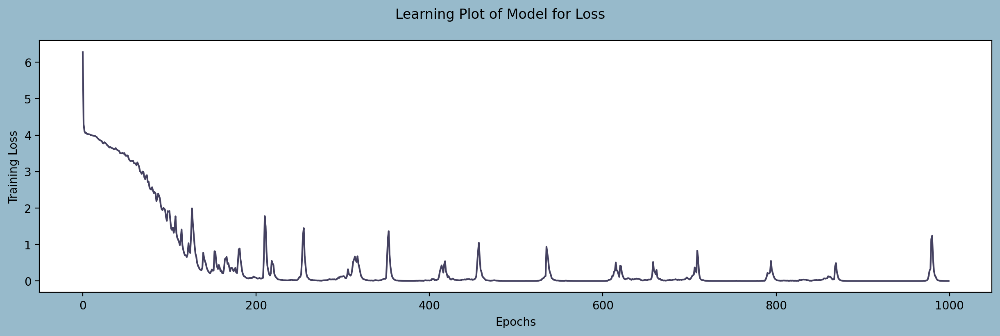

In [21]:
#Plotting the learnings 
history_df = pd.DataFrame(history.history)
fig = plt.figure(figsize=(15,4), facecolor="#97BACB")
fig.suptitle("Learning Plot of Model for Loss")
pl=sns.lineplot(data=history_df["loss"],color="#444160")
pl.set(ylabel ="Training Loss")
pl.set(xlabel ="Epochs")
plt.show()


This sure looks like music! To check if it sounds like music we have to listen to the MIDI file. Playing midi is crumblesome. I have saved and converted a few generated melodies to ".wav" format outside of this notebook. So let us have a listen. 

**Melody Generated Sample 1**

In [22]:
# Generate a melody using the trained model and a seed sequence
def generate_melody(model, seed, length, mapping):
	melody = []
	for _ in range(length):
		seed = np.reshape(seed, (1, len(seed), 1))
		prediction = model.predict(seed, verbose=0)
		index = np.argmax(prediction)
		result = mapping[index]
		melody.append(result)
		seed = np.append(seed[0][1:], [[index / float(len(mapping))]], axis=0)
	return melody

# Define the length of the melody to generate
melody_length = 100

# Select a seed sequence from the training data
X_seed = X[0]

# Generate the melody
Melody = generate_melody(model, X_seed, melody_length, reverse_mapping)

# Convert the generated melody to a music21 stream
stream_Melody = stream.Stream()
for note_str in Melody:
	if '.' in note_str or note_str.isdigit():
		chord_notes = note_str.split('.')
		chord_notes = [int(n) for n in chord_notes]
		new_chord = chord.Chord(chord_notes)
		stream_Melody.append(new_chord)
	else:
		new_note = note.Note(note_str)
		stream_Melody.append(new_note)

# Save the generated melody as a MIDI file
stream_Melody.write('midi', fp='Melody_generated_tschai.mid')

# Play the generated melody
IPython.display.Audio("Melody_generated_tschai.wav")